# CLINT WP5: MultiMaps of anomaly of drivers (w/r to 1981-2010) in detected areas and periods. 
## Possibility to check drivers anomalies and check the 
### 2023/08/30 

In [91]:
import numpy as np
import pandas as pd
import xarray as xr
import netCDF4 as nc
from datetime import datetime as dt
import matplotlib.dates as mdates
import matplotlib.pyplot as plt
import matplotlib as mpl
import cartopy.crs as ccrs
import cartopy
import importlib
import seaborn as sns
#from mpl_toolkits import Basemap
import CLINT001_functions as clint
importlib.reload(clint)

<module 'CLINT001_functions' from '/Users/antonellosquintu/Library/Mobile Documents/com~apple~CloudDocs/CMCC-iCloud/CLINT/CLINT001_functions.py'>

In [92]:
## DIRECTORIES
machine = 'workstation'

if machine == 'laptop':
    modeldir = '~/Documents/CMCC-GoogleDrive/ERA5/'
    maskdir = '~/Documents/CMCC-GoogleDrive/Mask_Clusters/Test3_Clusters/'
    plotdir = '/Users/squintu/Documents/CMCC-GoogleDrive/plots_for_reports/'
    
if machine == 'workstation':
    modeldir = '~/Documents/CMCC-GoogleDrive/ERA5/'
    maskdir = '~/Documents/CMCC-GoogleDrive/Mask_Clusters/Test3_Clusters/'
    plotdir = '/Users/antonellosquintu/Documents/CMCC-GoogleDrive/plots_for_reports/'

In [122]:
## Open land-sea mask and round to integer
## The mask has values between 0 and 1 according to the proportion of the grid-point
##  which is covered by land
## Any gridpoint with more than 0.5 is rounded to 1 and considered land

lsm = xr.open_dataset(f'{modeldir}/era5_lsm.nc').round()

In [123]:
### Read series of tmax and HWMI related to Lake Como
lchw = pd.read_csv('LakeComo_tmax_HW.csv',index_col='date')

In [124]:
### Identify 2019 heat wave

row_maxHWMI = lchw.loc[lchw['Valle_HWintensity'].idxmax()]
date2019_dt = dt.strptime(row_maxHWMI.name,"%Y-%m-%d")
date2019_ts = pd.to_datetime(date2019_dt)

In [125]:
### Identify dates
date_aux_dt = dt.strptime(lchw.loc[lchw.year==1983]['Valle_HWintensity'].idxmax(),"%Y-%m-%d")
date_aux_ts = pd.to_datetime(date_aux_dt)

In [126]:
date_aux_ts

Timestamp('1983-07-21 00:00:00')

In [127]:
where = 'Valle'

dates_ts = (pd.to_datetime("2022-07-22"), 
            pd.to_datetime("2019-06-27"), 
            pd.to_datetime("2003-08-11"), 
            pd.to_datetime("1983-07-21"))
#dates_ts = [pd.to_datetime("1983-07-21")]
vars = ('tmax','mslp')

In [128]:
drivers = pd.read_csv('./metadata/drivers.csv')
var='tmax'
y=2022
drivers_sub = drivers.loc[drivers['var'] == var]
drivers_row = drivers_sub.iloc[1]
targetdate_ts = pd.to_datetime("2022-07-22")
xrdf = anom_xr = xr.open_dataset(f'{modeldir}/era5_{var}_dailyanom_{y}_cropped.nc')

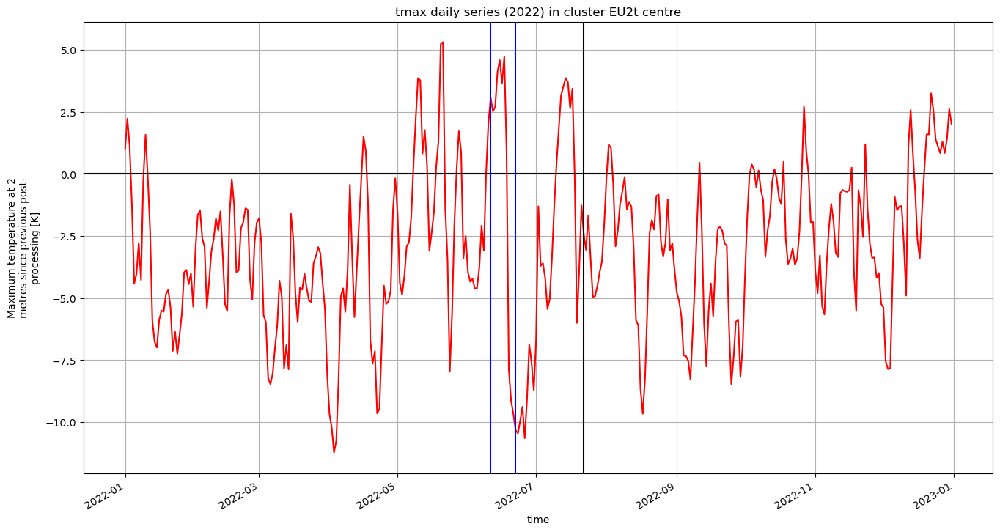

In [129]:
    y = targetdate_ts.year
    
    cc_lon = drivers_row['cluster_centre_lon']
    cc_lat = drivers_row['cluster_centre_lat']

    cc_ser = xrdf.sel(longitude = cc_lon, latitude = cc_lat)
    var = drivers_row['var']
    ncvar = drivers_row['nc_var']
    cl_name = drivers_row['cluster']
    
    minlag = int(drivers_row['minlag'])
    maxlag = int(drivers_row['maxlag'])
    # Determine extremes of the date range considered
    mintime_ts = targetdate_ts - pd.DateOffset(days = maxlag)# + pd.DateOffset(hours = 12)
    maxtime_ts = targetdate_ts - pd.DateOffset(days = minlag)# + pd.DateOffset(hours = 12)
    
    plt.rcParams['figure.figsize'] = [16,8]
    plt.figure()

    cc_ser[ncvar].plot(color='red')
    plt.title(f'{var} daily series ({y}) in cluster {cl_name} centre')
    plt.axhline(y=0, color='k')
    plt.axvline(x = targetdate_ts, color = 'k', label = 'axvline - full height')
    plt.axvline(x = mintime_ts, color = 'b', label = 'axvline - full height')
    plt.axvline(x = maxtime_ts, color = 'b', label = 'axvline - full height')
    plt.grid()
    #plt.savefig(f"{plotdir}CLINT050_{y}case_{var}_{cl_name}.png", facecolor='w')
    plt.show()  


In [130]:
tx2019_df = cc_ser[ncvar].to_pandas()
tx2019_df.rename('tmax')

tx2019_df.loc[tx2019_df>2]



time
2022-01-02    2.224793
2022-05-09    2.222874
2022-05-10    3.857904
2022-05-11    3.770580
2022-05-20    5.226063
2022-05-21    5.306761
2022-06-10    2.038332
2022-06-11    3.060925
2022-06-12    2.523794
2022-06-13    2.694467
2022-06-14    4.102131
2022-06-15    4.583305
2022-06-16    3.645463
2022-06-17    4.720495
2022-07-12    3.165033
2022-07-13    3.510439
2022-07-14    3.861906
2022-07-15    3.699769
2022-07-16    2.642697
2022-07-17    3.437844
2022-10-27    2.714133
2022-12-13    2.577964
2022-12-22    3.247791
2022-12-23    2.567531
2022-12-30    2.610469
dtype: float32

### Find a new (reverse) case 

The period from 2022-07-12 to 2022-07-17 has the largest anomaly
This driver has a lead time of 30 to 41 days. 35 days after 2022-07-14 is 2022-08-18
How is the HWMI on the target date?

In [131]:
date_str = '2022-08-18'

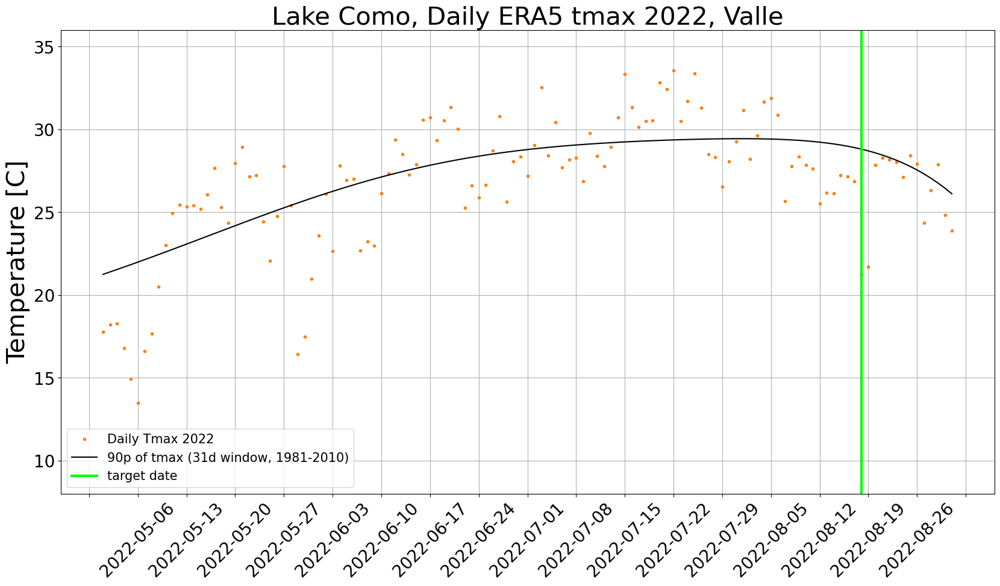

In [132]:
plt.rcParams['figure.figsize'] = [20,10]

fig, ax = plt.subplots()
ax.plot(lchw[lchw.year==y][f'{where}_Tmax'], marker='.',
         linestyle='none',c='tab:orange', label = f'Daily Tmax {y}')
ax.plot(lchw[lchw.year==y][f'{where}_pc90'],c='black', label = '90p of tmax (31d window, 1981-2010)')

plt.title(f'Lake Como, Daily ERA5 tmax {y}, {where}',fontsize=30)
#plt.xlabel(f'Days of {y}', fontsize=30)
plt.xlabel(None)
plt.ylabel(f'Temperature [C]', fontsize=30)
plt.grid(True)
ax.xaxis.set_major_locator(mdates.WeekdayLocator(interval=1))
plt.xticks(rotation=45,fontsize=20)
plt.yticks(fontsize=20)
#ax.xaxis.set_major_formatter(DateFormatter("%m-%d"))
plt.ylim([8,36])
plt.axvline(x = date_str, color = 'lime', label = 'target date', lw=3)
ax.legend(loc='lower left',fontsize=15)

fig.savefig(f"{plotdir}CLINT016_LakeComo_{where}_{y}_dailytmax.png", facecolor='w')

### how do the other drivers look like?
### 

In [133]:
dates_ts = (pd.to_datetime("2022-07-22"), 
            pd.to_datetime("2019-06-27"), 
            pd.to_datetime("2003-08-11"), 
            pd.to_datetime("1983-07-21"))
dates_ts = [pd.to_datetime("2022-08-18")]
variables = ('tmax','mslp','sm')

2022


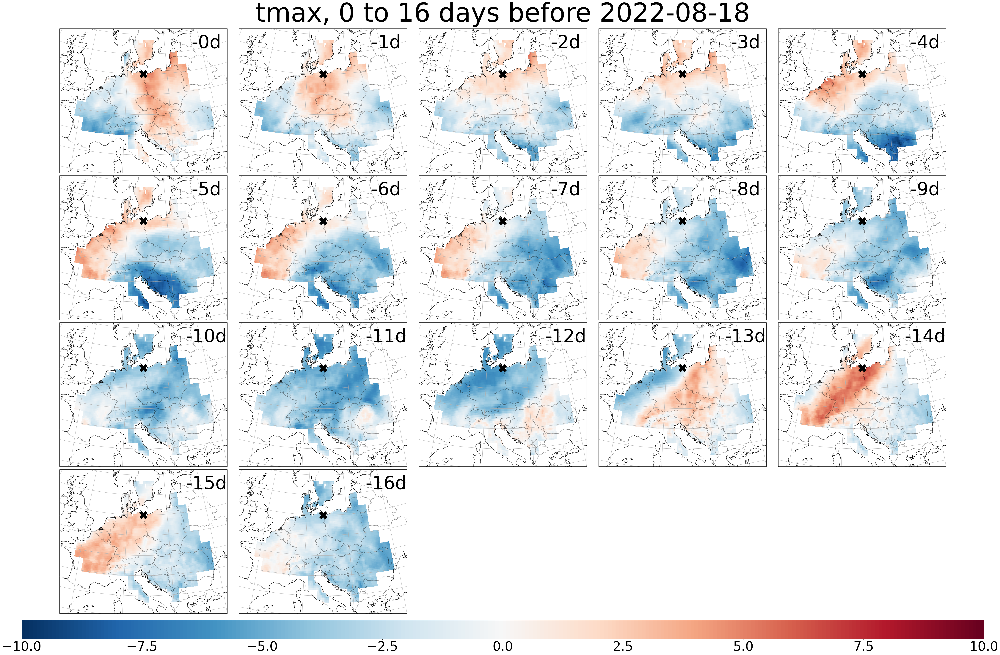

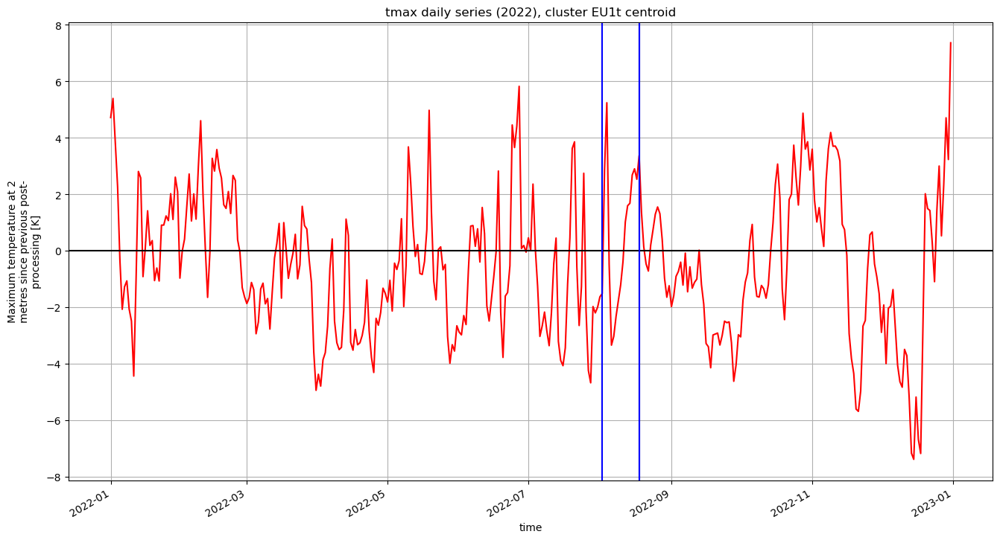

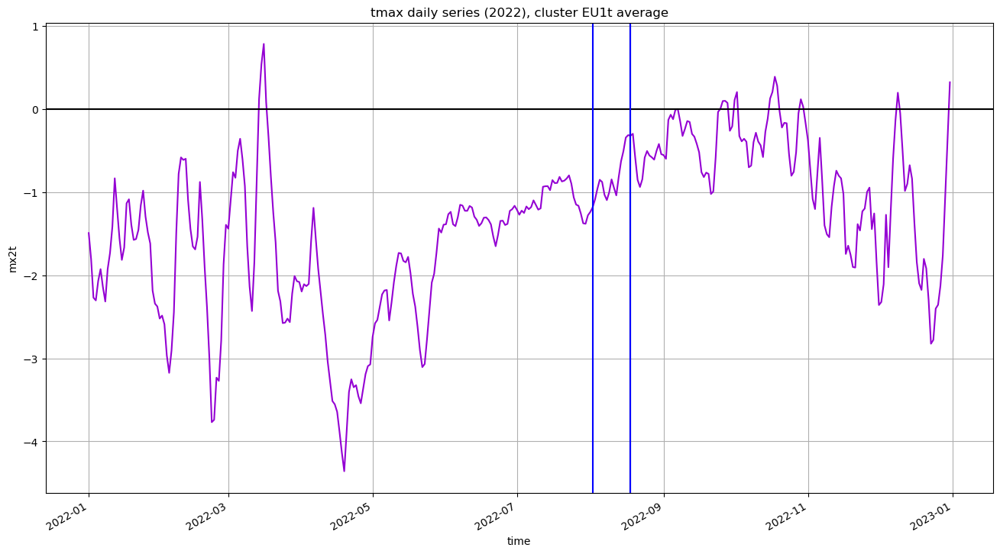

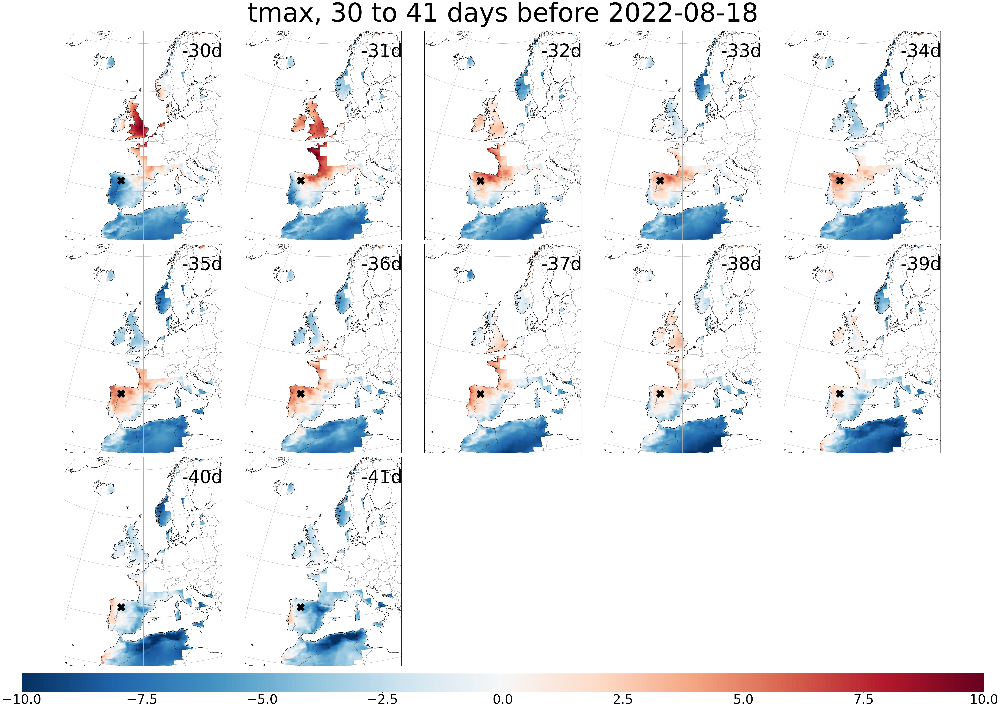

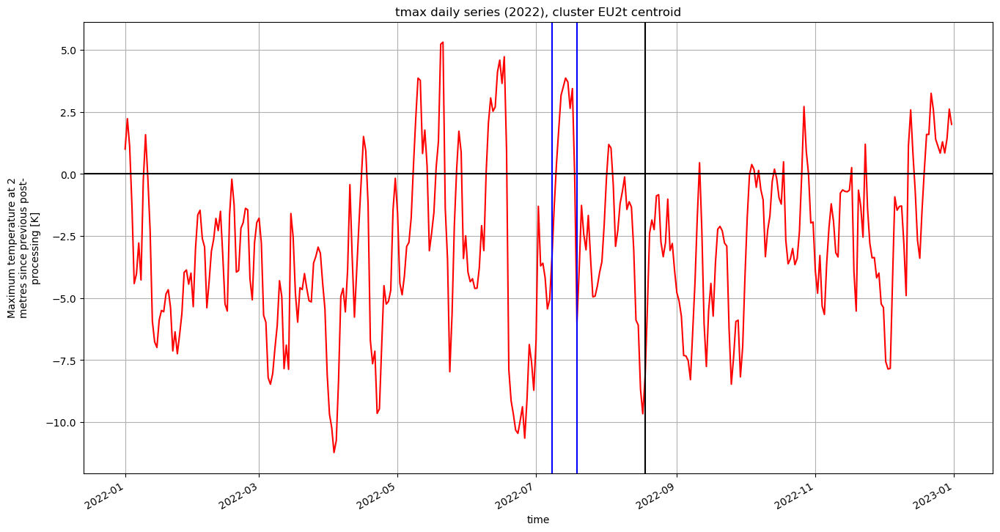

...

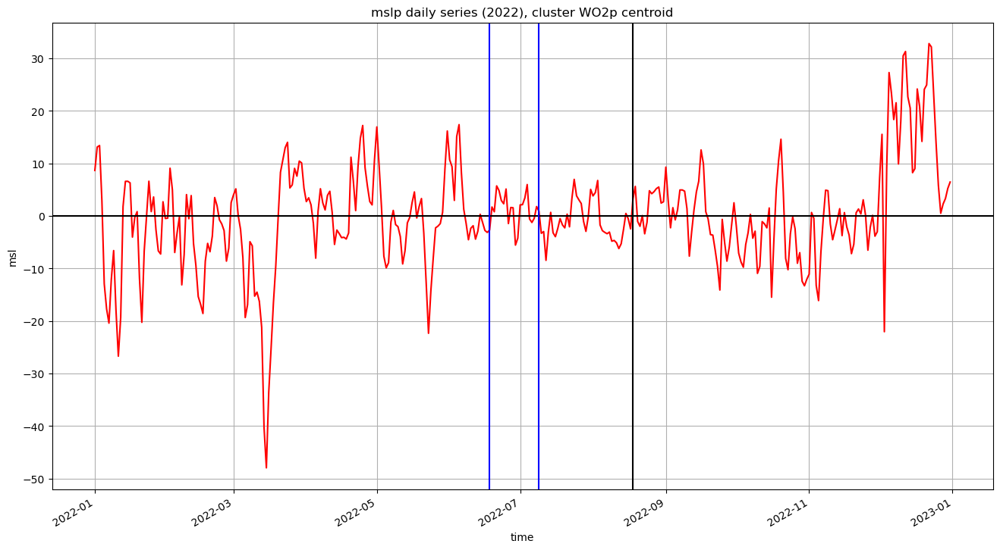

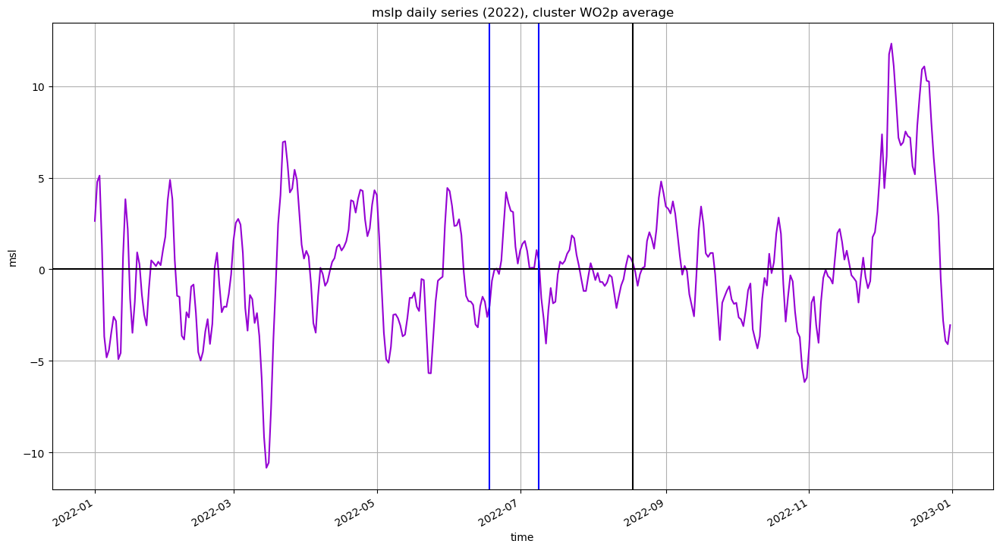

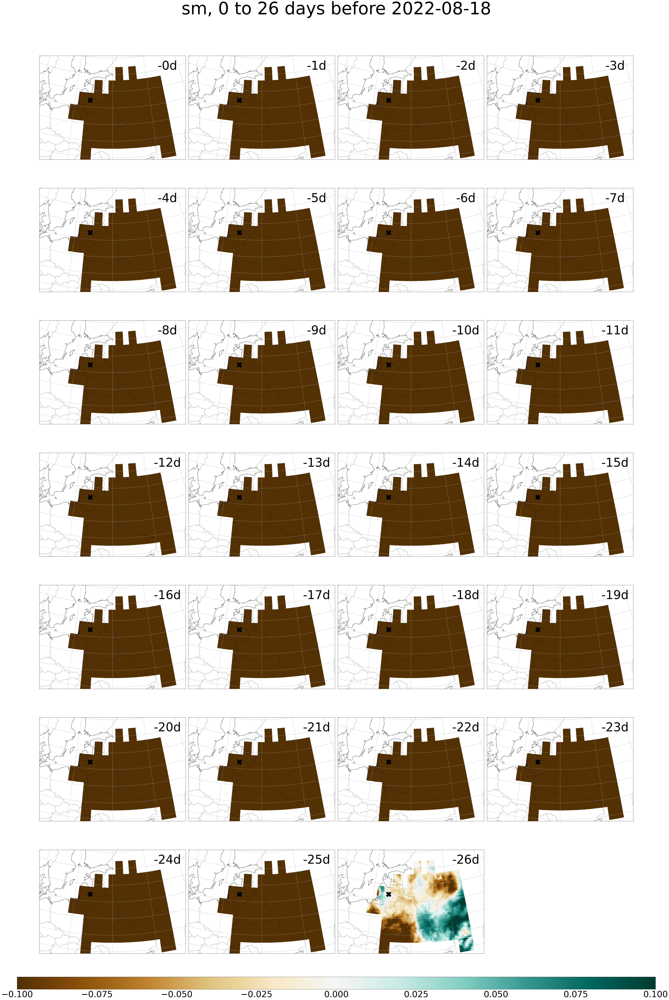

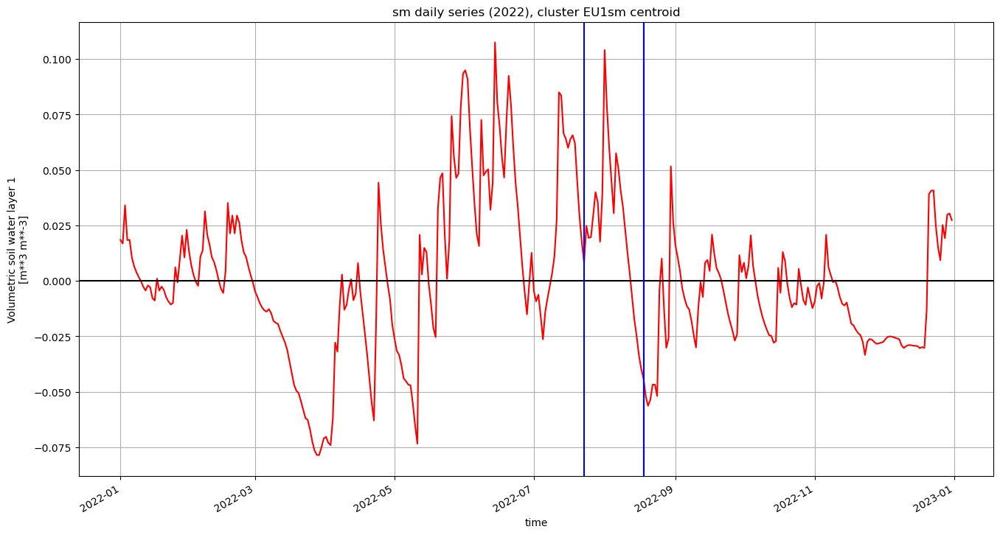

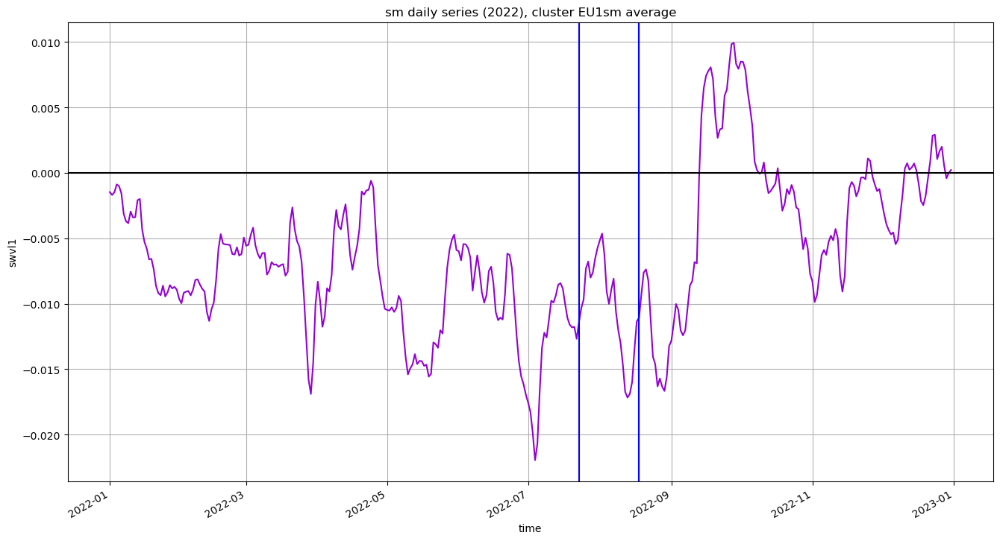

In [136]:
importlib.reload(clint)
drivers = pd.read_csv('./metadata/drivers.csv')
clint.loop_map_grids(drivers, dates_ts, variables, lsm, modeldir, maskdir, plotdir)

KeyError: "not all values found in index 'time'. Try setting the `method` keyword argument (example: method='nearest')."

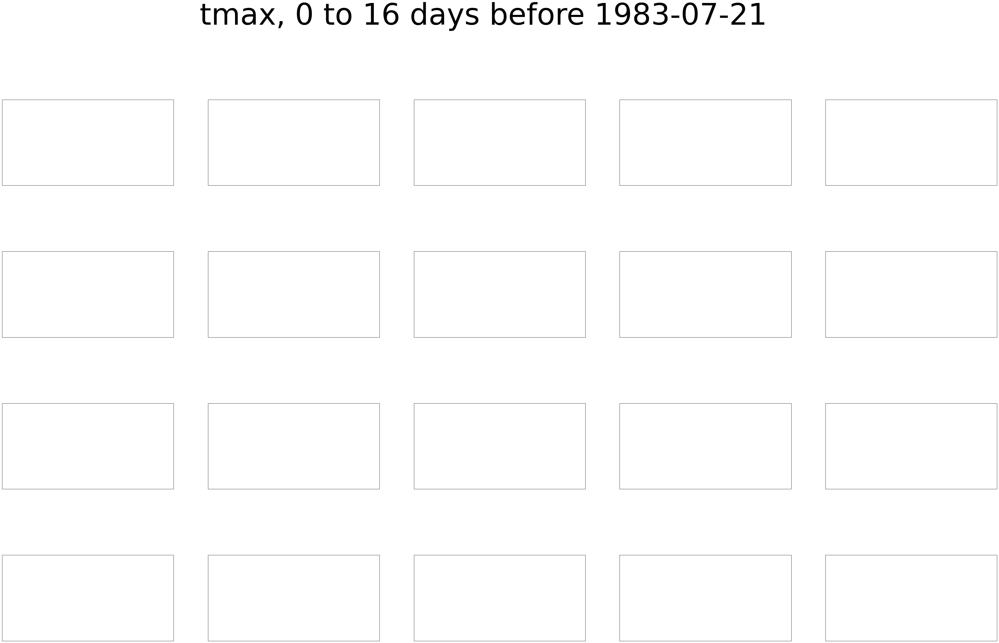

In [44]:
date_ts = pd.to_datetime("1983-07-21")
vars = ('tmax','mslp')
for var in vars:
    drivers_sub = drivers.loc[drivers['var'] == var]
    anom_xr = xr.open_dataset(f'{modeldir}/era5_{var}_dailyanom_{y}_cropped.nc')
    if var == 'mslp':
        anom_xr['msl'] = anom_xr['msl']/100
    importlib.reload(clint)
    for index, drivers_row in drivers_sub.iterrows():


        mask_df = pd.read_csv(f"{maskdir}{drivers_row['clmask_test3']}",index_col=[0])
        cl_nr = drivers_row['cl_nr']
        submask = mask_df[mask_df.cluster == cl_nr]
        maskedanom = clint.mask_xr_w_df(anom_xr, submask)

        clint.multimaps_lag (xrdf = maskedanom, targetdate_ts = date_ts, 
                             drivers_row = drivers_row, plotdir = plotdir,
                             proj = 'Ortographic', 
                             vmin='drivers', vmax='drivers')

        clint.daily_series_w_lags(anom_xr, drivers_row, date_ts, plotdir)

In [42]:
vars

<function vars>